In [1]:
#Importing packages
import numpy as np
import pandas as pd
import random
import math
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D

from astropy.io import fits
import astropy.constants as const
import astropy.units as u

import argparse
import sys

from IPython.display import HTML

# Start with well-defined slab

In [ ]:
#Constants
cross_section_T = 6.652e-25 * (u.cm ** 2) #Thompson cross-section
mfp = 150.0 * (u.m) #mean free path, where n and the cross-section are well-defined
slab_width = (1.0 * (u.km)).to(u.m) #width of slab

#Simulation parameters
start_x = slab_width.value / 2 #Center of slab
start_y = slab_width.value / 2
start_angle = 0.0

max_scatters = 30 #Limit for number of frames in the simulation
time_delay = 200 #Time delay between frames in animation (milliseconds)

#Initalizing simulation data globally
x_positions = [start_x] #Array of all the photon's positions
y_positions = [start_y]

total_dist = 0.0 #Total distance traveled by photon (in meters)
sim_exit = False

In [ ]:
def transformation_method(L = mfp.value):
    """
        This function returns the distance the photon travels after it scatters off an electron. The probability is
        an exponential function, which is why we're using the transformation method. The distance changes based
        on the random probability generated with the numpy random function.
        
        Parameter:
            L (float) = Fixed mean free path (150 meters)
            
        Returns:
            dist (float) = Distance photon travels (meters)
    """
    
    dist = -L * np.log(np.random.rand()) #Random() returns "random" number between 0-1 (represents probability)
    
    return dist

In [ ]:
def thompson_angle():
    
    """
        This function calculates and returns the photon's angle, based on a random number between -π to π.
        
        Returns:
            theta (float) = Photon's angle with respect to the photon's current direction
    """
    
    theta = np.pi * random.uniform(-1, 1) #Picks random angle between -π to π 
    
    return theta

In [ ]:
def simulate_one_scatter(x_positions, y_positions, total_dist): #Debugged with Claude.ai
    
    """
        This function simulates one scatter event, and it's called on once per animation frame. It returns
        the x/y positions (x_position and y_position), total distance traveled by the photon (total_dist),
        and whether or not the photon left the slab (exit).
        
        Parameters:
            x_positions (np.array) = Array of all the photon's x-coordinates (both starting and current)
            y_positions (np.array) = Array of all the photon's y-coordinates (both starting and current)
            total_dist (float) = Total distance traveled by the photon (meters)
        
        Variables:
            starting_x/y (float) = Point where photon scatters - last x and y-coordinates in the arrays
            distance (float) = Distance until next scatter, which is determined by the transformation method
            angle (float) = Angle of scatter with respect to the direction of motion, determined by the Thompson's Angle equation
            delta_x/y (float) = Change in c and y-coordinates after the scattering event
            current_x/y (float) = Current coordinates are dependent on the sum of the starting x/y-coords and the change in                                         coordinates (delta x/y)
            
        Returns:
           x_positions (np.array) = Array of all the photon's x-coordinates (both starting and current)
           y_positions (np.array) = Array of all the photon's y-coordinates (both starting and current)
           total_dist (float) = Total distance traveled by the photon (meters)
           time (float) = Total time it took for the photon to travel out of the slab (seconds)
           exit (boolean) = Return "True" when the photon exits the slab / "False" when photon is still inside the slab
        
    """
    
    #Initializing current position
    starting_x = x_positions[-1] 
    starting_y = y_positions[-1]

    #Distance to next scatter
    distance = transformation_method()

    #Position before the scatter
    angle = thompson_angle()

    delta_x = distance * np.cos(angle)
    delta_y = distance * np.sin(angle)

    current_x = starting_x + delta_x 
    current_y = starting_y + delta_y

    #Append new positions to arrays
    x_positions.append(current_x)
    y_positions.append(current_y)

    #Determining the total distance
    total_dist += distance #Total distance traveled
    time = (total_dist * u.m) / const.c #Total time elapsed  (t = total_dist / speed of light)

    exit = False
    
    #Stopping loop once photon leaves the slab
    if (current_x > slab_width.value) or (current_x < 0.0):
        exit = True

    if (current_y > slab_width.value) or (current_y < 0.0):
        exit = True

    #Checking whether the photon traveled back to the center of the slab
    if (current_x == start_x) and (current_y == start_y): #Restarts the whole method

        x_positions = [start_x] #Array of all the photon's positions
        y_positions = [start_y]

        current_x = start_x #Current position changes after every scattering event (starts at the center)
        current_y = start_y

        total_dist = 0
    
    return x_positions, y_positions, total_dist, time, exit

In [ ]:
def init(): #Taken from Gemini AI
    """Initialization function for the animation."""
    line.set_data([], [])
    scat_point.set_data([], [])
    current_point.set_data([], [])
    
    return line, scat_point, current_point

In [ ]:
def update_animation(frame): #Code debugged by Claude.ai
    """ 
        This function is by FuncAnimation for each frame, which updates each new scattering event in the animation. 
        
        Parameters:
            frame (int) = Represents each frame of the animation (dependent on the max_scatter value)
            
        Returns:
            line (object) = Set of data representing the distances between each scattering event
            scat_point (object) = Set of data points corresponding to each scattering location (pink in the gif)
            current_point (object) = Set of data points corresponding to the photon's current position (green in the gif)
        
    """    
    global x_positions, y_positions, total_dist, sim_exit #Variables defined outside this function (initializers)
    
    if sim_exit == True: #Ends the whole function/animation
        return line, scat_point, current_point
    
    #Run one scatter event
    x_positions, y_positions, total_dist, time, sim_exit = simulate_one_scatter(x_positions, y_positions, total_dist)
    
    #Update line (photon path)
    line.set_data(x_positions, y_positions)
    
    #Updates points of scatter
    if len(x_positions) > 1: #If there is more than 1 coordinate
        scat_point.set_data(x_positions[:-1], y_positions[:-1]) #Scatter point = second-to-last coordinate
        
    #Updates current positions
    current_point.set_data(x_positions[-1], y_positions[-1]) #Current point = last udpated coordinate
    
    #Updates title with every frame
    ax.set_title(f'Photon Scattering In Slab | L: {mfp.value} m | Scatters: {len(x_positions) - 1}', fontsize = 15)
    
    #Update stats text box (total distance and time)
    stats_text.set_text(f'Total Distance: {total_dist:.3f} m\n'
                       f'Time Elapsed: {time.to(u.microsecond):.3f}')
    
    return line, scat_point, current_point, stats_text

In [ ]:
##Configure animation##

#Animation set-up
fig, ax = plt.subplots(figsize=(12, 10))
line, = ax.plot([], [], color = 'black', linewidth=1.5, label='Photon Path')
scat_point, = ax.plot([], [], 'o', color = 'deeppink', markersize=6, label='Scattering Event')
current_point, = ax.plot([], [], 'o', color = 'mediumspringgreen', markersize=8, label='Current Position')

#Plot configuration
ax.set_xlim(-slab_width.value/2, slab_width.value * 1.5)
ax.set_ylim(-slab_width.value/2, slab_width.value * 1.5)

ax.set_aspect('equal', adjustable='box')

ax.set_title(f'Photon Scattering In Slab | L: {mfp.value} m', fontsize = 15)
ax.set_xlabel('x (m)', fontsize = 15)
ax.set_ylabel('y (m)', fontsize = 15)

ax.axvline(0, color='blue', linestyle='--', linewidth=2, label='Slab Boundary')
ax.axvline(slab_width.value, color='blue', linestyle='--', linewidth=2)
ax.axvspan(0, slab_width.value, color='blue', alpha=0.1, label='Slab Region')

# Add text box for stats
stats_text = ax.text(0.02, 0.98, '', transform=ax.transAxes, 
                     fontsize=12, verticalalignment='bottom',
                     bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))

ax.legend(loc = 'lower right', fontsize = 12)

# Create the animation
anim = FuncAnimation(
    fig,
    update_animation,
    frames = range(max_scatters),
    init_func = init,
    blit = True,
    interval = time_delay,
    repeat = False
)

# Save and display as HTML
HTML(anim.to_jshtml())

# Now simulate photons scattering through the Sun

In [2]:
#Simulation parameters
cross_section_T = 6.652e-25 * (u.cm ** 2) #Thompson cross-section

solar_start_x = 0.0 #Center of the Sun (do I use Cartesian or Polar coordinates?)
solar_start_y = 0.0
solar_start_z = 0.0
start_angle = 0.0

solar_max_scatters = 200 #Limit for number of frames in the simulation
solar_time_delay = 100 #Time delay between frames in animation (milliseconds)

#Initalizing simulation data globally
solar_x_positions = [solar_start_x] #Array of all the photon's positions
solar_y_positions = [solar_start_y]
solar_z_positions = [solar_start_z]

solar_total_dist = 0.0 #Total distance traveled by photon (in meters)
solar_time = 0.0 * u.s
radius = 0.0 #Photon's distance from the center of the Sun
solar_sim_exit = False

In [3]:
def solar_mean_free_path(radius, cross_section = cross_section_T):
    
    """
        This function calculates the mean free path based on the current radius. It returns the distance the 
        photon traveled between the scatter and current point.
    """
    
    #Electron density of the Sun depends on the photon's distance from the center (r) --> Is r randomly generated?
    n_e = (2.5e26 * np.exp(-(radius) / (0.096 * u.R_sun).to(u.m).value)) * (u.cm ** -3) 
    
    #Calculating mean free path (dependent on electron density and Thompson's cross-section)
    L = 1.0 / (n_e * cross_section)
    
    #Scaling up for visualization (real mean free path is too small to see in an animation)
    vis_scale = 1e11 #Scale up by an order of 1 billion
    
    return (L.to(u.m)).value * vis_scale

In [4]:
#Thompson angle equation will remain the same

In [5]:
def simulate_solar_scatter(x_positions, y_positions, z_positions, total_dist): #Debugged with Claude.ai
    
    """
        This function simulates one scatter event, and it's called on once per animation frame. It returns
        the x/y/z positions (x_positions, y_positions, z_positions), total distance traveled by the photon (total_dist),
        the distance of the photon from the center of the Sun (radius), the time elapsed for a photon to leave the
        Sun (time), and whether or not the photon left the Sun (exit).
        
        Parameters:
            x_positions (np.array) = Array of all the photon's x-coordinates (both starting and current)
            y_positions (np.array) = Array of all the photon's y-coordinates (both starting and current)
            z_positions (np.array) = Array of all the photon's z-coordinates (both starting and current)
            total_dist (float) = Total distance traveled by the photon (meters)
        
        Variables:
            starting_x/y/z (float) = Point where photon scatters - last x/y/z-coordinates in the arrays
            distance (float) = Distance until next scatter, which is determined by the solar_mean_free_path() method
            angle (float) = Angle of scatter with respect to the direction of motion, determined by the Thompson's Angle equation
            delta_x/y/z (float) = Change in x/y/z-coordinates after the scattering event
            current_x/y/z (float) = Current coordinates are dependent on the sum of the starting x/y/z-coords and the change in                                         coordinates (delta x/y)
            
        Returns:
           x_positions (np.array) = Array of all the photon's x-coordinates (both starting and current)
           y_positions (np.array) = Array of all the photon's y-coordinates (both starting and current)
           z_positions (np.array) = Array of all the photon's z-coordinates (both starting and current)
           total_dist (float) = Total distance traveled by the photon (meters)
           radius (float) = Photon's distance from the Sun's center (meters)
           time (float) = Total time it took for the photon to travel out of the slab (seconds)
           exit (boolean) = Return "True" when the photon exits the slab / "False" when photon is still inside the slab
        
    """
    
    #Initializing current position
    starting_x = x_positions[-1] 
    starting_y = y_positions[-1]
    starting_z = z_positions[-1]
    
    #Current radius
    current_radius = np.sqrt(np.square(starting_x) + np.square(starting_y) + np.square(starting_z))

    #Distance to next scatter
    distance = solar_mean_free_path(current_radius)

    #Angles relative to direction of motion
    phi = random.uniform(0.0, 2.0 * np.pi) #Azimuthal angles
    theta = random.uniform(-np.pi, np.pi) #Polar angle

    #Direction vector components
    delta_x = distance * np.sin(theta) * np.cos(phi)
    delta_y = distance * np.sin(theta) * np.sin(phi)
    delta_z = distance * np.cos(theta)

    #New position
    current_x = starting_x + delta_x 
    current_y = starting_y + delta_y
    current_z = starting_y + delta_z

    #Append new positions to arrays
    x_positions.append(current_x)
    y_positions.append(current_y)
    z_positions.append(current_z)

    #Determining the total distance
    total_dist += distance #Total distance traveled
    time = (total_dist * u.m) / const.c #Total time elapsed  (t = total_dist / speed of light)

    exit = False
    
    #Stopping loop once photon "leaves" the Sun
    if (current_radius >= (0.9 * const.R_sun).to(u.m).value): #Density drops quickly and photon longer scatters at this point
        exit = True

    #Checking whether the photon traveled back to the center of the slab
    if (current_x == solar_start_x) and (current_y == solar_start_y) and (current_z == solar_start_z): #Restarts the whole method

        x_positions = [solar_start_x] #Array of all the photon's positions
        y_positions = [solar_start_y]
        z_positions = [solar_start_z]

        current_x = solar_start_x #Current position changes after every scattering event (starts at the center)
        current_y = solar_start_y
        current_z = solar_start_z

        total_dist = 0.0
        radius = 0.0
    
    return x_positions, y_positions, z_positions, total_dist, current_radius, time, exit

In [6]:
def solar_init(): #Updated with Claude.ai
    """Initialization function for the animation."""
    solar_line.set_data(np.array([]), np.array([]))
    solar_line.set_3d_properties(np.array([]))
    
    solar_scat_point.set_data(np.array([]), np.array([]))
    solar_scat_point.set_3d_properties(np.array([]))
    
    solar_current_point.set_data(np.array([]), np.array([]))
    solar_current_point.set_3d_properties(np.array([]))
    
    return solar_line, solar_scat_point, solar_current_point, stats_text

In [7]:
def update_solar_animation(frame): #Code debugged by Claude.ai
    """ 
        This function is by FuncAnimation for each frame, which updates each new scattering event in the solar
        animation. 
        
        Parameters:
            frame (int) = Represents each frame of the animation (dependent on the max_scatter value)
            
        Returns:
            solar_line (object) = Set of data representing the distances between each scattering event
            solar_scat_point (object) = Set of data points corresponding to each scattering location (pink in the gif)
            solar_current_point (object) = Set of data points corresponding to the photon's current position (green in the gif)
        
    """   
    #Variables defined outside this function (initializers)
    global solar_x_positions, solar_y_positions, solar_z_positions
    global solar_total_dist, solar_sim_exit, solar_time
    
    if solar_sim_exit == True: #Ends the whole function/animation
        return solar_line, solar_scat_point, solar_current_point, stats_text
    
    #Run one scatter event
    solar_x_positions, solar_y_positions, solar_z_positions, solar_total_dist, radius, solar_time, solar_sim_exit = simulate_solar_scatter(
        solar_x_positions, solar_y_positions, solar_z_positions, solar_total_dist
    )
    
    # Debug: Print current position
    print(f"Frame {frame}: Position = ({solar_x_positions[-1]:.2e}, {solar_y_positions[-1]:.2e}, {solar_z_positions[-1]:.2e}), Radius = {radius:.2e} m")
    
    #Update line (photon path)
    solar_line.set_data(np.array(solar_x_positions), np.array(solar_y_positions))
    solar_line.set_3d_properties(np.array(solar_z_positions))
    
    #Updates points of scatter
    if len(solar_x_positions) > 1: #If there is more than 1 coordinate
        solar_scat_point.set_data(np.array(solar_x_positions[:-1]), np.array(solar_y_positions[:-1])) #Scatter point = second-to-last coordinate
        solar_scat_point.set_3d_properties(np.array(solar_z_positions[:-1]))
        
    #Updates current positions
    solar_current_point.set_data(np.array(solar_x_positions[-1]), np.array(solar_y_positions[-1])) #Current point = last udpated coordinate
    solar_current_point.set_3d_properties(np.array(solar_z_positions[-1]))
    
    #Updates title with every frame
    ax.set_title(f'Solar Photon Scattering | L = {solar_mean_free_path(radius):.2f} m | Scatters: {len(solar_x_positions) - 1}', fontsize = 15)
    
    #Update stats text box (total distance and time)
    stats_text.set_text(f'Total Distance: {solar_total_dist:.3e} m\n'
                        f'Radius: {(radius * u.m).to(u.R_sun):.3e}\n'
                       f'Time Elapsed: {solar_time.to(u.microsecond):.3e}')
    
    return solar_line, solar_scat_point, solar_current_point, stats_text

Frame 0: Position = (4.04e+06, -3.90e+06, 2.15e+06), Radius = 0.00e+00 m
Frame 1: Position = (2.62e+05, 8.62e+05, -6.42e+06), Radius = 6.01e+06 m
Frame 2: Position = (5.25e+05, 1.09e+06, 7.48e+06), Radius = 6.48e+06 m
Frame 3: Position = (2.25e+06, 6.98e+06, -1.69e+06), Radius = 7.58e+06 m
Frame 4: Position = (2.45e+06, 2.08e+06, 1.16e+07), Radius = 7.53e+06 m
Frame 5: Position = (-2.06e+06, 7.42e+06, 3.81e+06), Radius = 1.20e+07 m
Frame 6: Position = (-4.43e+06, 6.80e+06, 1.03e+06), Radius = 8.59e+06 m
Frame 7: Position = (-4.49e+06, 1.27e+07, 1.02e+07), Radius = 8.18e+06 m
Frame 8: Position = (-5.50e+06, 1.37e+07, 5.09e+06), Radius = 1.69e+07 m
Frame 9: Position = (-7.40e+06, 1.57e+07, 6.59e+06), Radius = 1.56e+07 m
Frame 10: Position = (-1.01e+07, 1.69e+07, 2.30e+07), Radius = 1.85e+07 m
Frame 11: Position = (-3.01e+06, 1.52e+07, 1.10e+07), Radius = 3.03e+07 m
Frame 12: Position = (-2.59e+06, 1.25e+07, 2.27e+07), Radius = 1.90e+07 m
Frame 13: Position = (3.48e+06, 7.43e+06, 8.53e+06

Frame 111: Position = (3.98e+07, -2.01e+06, -3.73e+05), Radius = 4.80e+07 m
Frame 112: Position = (4.20e+07, 6.41e+06, 4.63e+06), Radius = 3.99e+07 m
Frame 113: Position = (4.12e+07, 6.62e+06, -4.96e+06), Radius = 4.27e+07 m
Frame 114: Position = (3.97e+07, 6.37e+06, 1.78e+07), Radius = 4.20e+07 m
Frame 115: Position = (4.95e+07, 4.56e+05, 4.23e+06), Radius = 4.40e+07 m
Frame 116: Position = (5.08e+07, 9.78e+04, -1.21e+07), Radius = 4.96e+07 m
Frame 117: Position = (5.20e+07, -5.31e+05, -1.30e+07), Radius = 5.23e+07 m
Frame 118: Position = (5.78e+07, 1.13e+07, 2.11e+06), Radius = 5.36e+07 m
Frame 119: Position = (4.50e+07, 5.01e+06, 1.39e+07), Radius = 5.89e+07 m
Frame 120: Position = (4.01e+07, 1.04e+07, 1.49e+07), Radius = 4.73e+07 m
Frame 121: Position = (3.92e+07, 2.12e+07, 1.45e+07), Radius = 4.40e+07 m
Frame 122: Position = (3.50e+07, 1.23e+07, 1.40e+07), Radius = 4.69e+07 m
Frame 123: Position = (3.01e+07, 6.77e+06, 4.38e+06), Radius = 3.97e+07 m
Frame 124: Position = (3.01e+07,

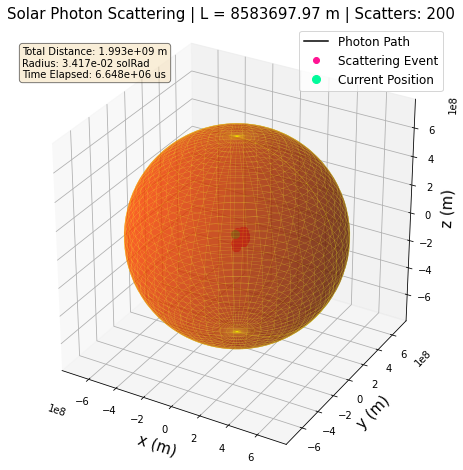

In [12]:
#Plotting sphere
solar_fig = plt.figure(figsize = (10, 8))
ax = solar_fig.add_subplot(111, projection = '3d')

plt.rcParams['animation.embed_limit'] = 50  # MB

#Creating spherical coordinates
theta = np.linspace(0.0, 2.0 * np.pi, 100)
phi = np.linspace(0.0, np.pi, 100)
x = np.outer(np.cos(theta), np.sin(phi)) * (const.R_sun).to(u.m)
y = np.outer(np.sin(theta), np.sin(phi))  * (const.R_sun).to(u.m)
z = np.outer(np.ones(np.size(theta)), np.cos(phi))  * (const.R_sun).to(u.m)

#Plotting sphere
ax.plot_surface(x, y, z, color = 'orangered', alpha = 0.6, edgecolor = 'none')

#Adding wireframe
ax.plot_wireframe(x, y, z, color = 'yellow', alpha = 0.2, linewidth = 0.5)

#Plotting the scatter points
solar_line, = ax.plot3D([], [], [], color = 'black', linewidth=1.5, label='Photon Path')
solar_scat_point, = ax.plot3D([], [], [], 'o', color = 'deeppink', markersize=6, label='Scattering Event')
solar_current_point, = ax.plot3D([], [], [], 'o', color = 'mediumspringgreen', markersize=8, label='Current Position')

#Stats text box (taking from Claude.ai)
stats_text = ax.text2D(0.02, 0.95, '', transform=ax.transAxes, fontsize=10,
                       verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

#Setting labels and title
ax.set_xlabel('x (m)', fontsize = 15)
ax.set_ylabel('y (m)', fontsize = 15)
ax.set_zlabel('z (m)', fontsize = 15)
ax.set_title('Sun', fontsize = 20)

# Set equal aspect ratio
ax.set_box_aspect([1,1,1])

ax.legend(loc = 'upper right', fontsize = 12)

#Axis limits
lim = (const.R_sun.to(u.m)).value * 1.1
ax.set_xlim([-lim, lim])
ax.set_ylim([-lim, lim])
ax.set_zlim([-lim, lim])

# Create the animation
anim = FuncAnimation(
    solar_fig,
    update_solar_animation,
    frames = range(solar_max_scatters),
    init_func = solar_init,
    blit = False, #Redraws entire figure each frame (slower but more reliable for 3D plots)
    interval = solar_time_delay,
    repeat = False
)

# Save and display as HTML
HTML(anim.to_jshtml())